In [ ]:
# citations of orignals:
# """
# first two attempts were DCGANs (result were mode collapse)
# MNIST DCGAN by TensorFlow Authors: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/dcgan.ipynb#scrollTo=ZBwyU6t2Wf3g
# Monet_ Dataset DCGAN architecture: https://www.kaggle.com/code/thuylinh225/generate-monet-images-using-dcgan
# naming convention for models: https://github.com/thashimoto1998/DCGAN/blob/master/dcgan.py
#
# third attempt is WGAN-GP (better results)
# WGAN-GP video: https://www.youtube.com/watch?v=pG0QZ7OddX4&list=PLhhyoLH6IjfwIp8bZnzX8QR30TRcHO8Va&index=5
# WGAN-GP paper: https://arxiv.org/abs/1704.00028
# WGAN-GP github: https://github.com/aladdinpersson/Machine-Learning-Collection/tree/master/ML/Pytorch/GANs/4.%20WGAN-GP
# """

In [ ]:
###############################
###         Updates         ###
###############################

#removed text cells
# added WGAN-GP
# added outputs folder to save GIFs
# figured out how to display colors for first_dcgan



In [ ]:
import glob
import imageio
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time
import matplotlib.image as mpimg

from IPython import display
from IPython.display import HTML
import zipfile
import re
from PIL import Image
import shutil
import matplotlib.animation as animation

In [ ]:
# import pandas as pd
# from torchvision.transforms import v2
# import tensorflow.keras as keras
# from tensorflow.keras import layers
# from tensorflow.keras import optimizers
# from tensorflow.keras.utils import plot_model
# from tensorflow.keras.initializers import RandomNormal
# from tensorflow.keras.models import Sequential, Model, load_model
# from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
# from tensorflow.keras.layers import BatchNormalization, Dropout
# from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
# from tensorflow.keras.optimizers import Adam

In [ ]:
#for WGAN-GP
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter

In [ ]:
!pip install tensorflow_docs
import tensorflow_docs.vis.embed as embed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.5/182.5 kB 1.3 MB/s eta 0:00:00


In [ ]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


In [ ]:
#Gather images
!git clone https://github.com/LyJacky/ImageGeneration.git

Cloning into 'ImageGeneration'...
remote: Enumerating objects: 370, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (38/38), done.
remote: Total 370 (delta 25), reused 65 (delta 25), pack-reused 305
Receiving objects: 100% (370/370), 49.29 MiB | 12.91 MiB/s, done.
Resolving deltas: 100% (25/25), done.


In [ ]:
# files = glob.glob(f"/content/ImageGeneration/monet_jpg/*.jpg")
data_path = glob.glob(f"/content/ImageGeneration/monet_jpg")

os.chdir(data_path[0])

data  = []
for file in os.listdir():
    if file.endswith(".jpg"):
        file_path = f"{data_path[0]}/{file}"
        img = mpimg.imread(file_path)
        data.append(img)

In [ ]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


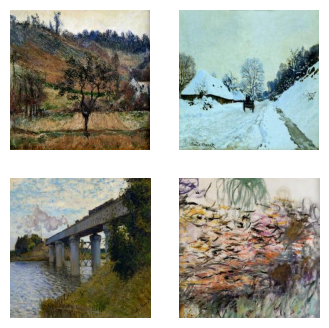

In [ ]:
# show some samples

fig = plt.figure(figsize=(4,4))
for i, img in enumerate(data[0:4]):
    plt.subplot(2, 2, i+1)
    plt.imshow(data[i])
    plt.axis('off')
plt.show()

In [ ]:
#############################
###    WGAN-GP Original    ###
#############################

In [ ]:
def gradient_penalty(disc, real, fake, device="cpu"):
  BATCH_SIZE, C, H, W = real.shape
  epsilon = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
  interpolated_images = real * epsilon + fake * (1 - epsilon)

  # calcuate discriminator scores
  mixed_scores = disc(interpolated_images)

  gradient = torch.autograd.grad(
      inputs = interpolated_images,
      outputs = mixed_scores,
      grad_outputs = torch.ones_like(mixed_scores),
      create_graph = True,
      retain_graph = True,
  )[0]

  gradient = gradient.view(gradient.shape[0], -1)
  gradient_norm = gradient.norm(2, dim=1)
  gradient_penalty = torch.mean((gradient - 1) ** 2)
  return gradient_penalty


In [ ]:
class Discriminator(nn.Module):
  def __init__(self, channels_img, features_d):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size = 4, stride = 2, padding = 1),
        nn.LeakyReLU(0.2),

        #_block(in_channels, out_channels, kernel_size, stride, padding)
        self._block(features_d, features_d * 2, 4, 2, 1),
        self._block(features_d * 2, features_d * 4, 4, 2, 1),
        self._block(features_d * 4, features_d * 8, 4, 2, 1),

        # output is 4x4 (Conv2d turns into 1x1)
        nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0)
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        # nn.BatchNorm2d(out_channels),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2),
    )

  def forward(self, x):
    return self.disc(x)

In [ ]:
class Generator(nn.Module):
  def __init__(self, channels_noise, channels_img, features_g):
    super(Generator, self).__init__()
    self.net = nn.Sequential(
        self._block(channels_noise, features_g * 16, 4, 1, 0),
        self._block(features_g * 16, features_g * 8, 4, 2, 1),
        self._block(features_g * 8, features_g * 4, 4, 2, 1),
        self._block(features_g * 4, features_g * 2, 4, 2, 1),
        nn.ConvTranspose2d(
            features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
        ),
        nn.Tanh(),
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
    )

  def forward(self, x):
    return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


def test():
    N, in_channels, H, W = 8, 3, 64, 64
    noise_dim = 100
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(in_channels, 8)
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(noise_dim, in_channels, 8)
    z = torch.randn((N, noise_dim, 1, 1))
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"


In [ ]:
import torchvision.transforms as transforms

In [ ]:
# hyperparameters

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
LEARNING_RATE = 1e-4
BATCH_SIZE = 32
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
FEATURES_DISC = 64
FEATURES_GEN = 64
DISC_ITERATIONS = 5
LAMBDA_GP = 10

transforms = transforms.Compose(
    [
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]
        ),
    ]
)

cuda


In [ ]:
# checkpoints

def save_checkpoints(state, filename="monet_wgan_gp.pth.tar"):
  print("=> Saving checkpoint")
  torch.save(state, filename)

def load_checpoint(checkpoint, gen, disc):
  print("=> Loading checkpoint")
  gen.load_state_dict(checkpoint['gen'])   # generator
  disc.load_state_dict(checkpoint['disc']) # discriminator

In [ ]:
def wgan_generate_images():
    noise = tf.random.normal([BATCH_SIZE, Z_DIM])
    # predictions = gen.predict(noise)
    fake = gen(noise)
    return fake

def wgan_generate_and_plot_images():
    image = wgan_generate_images()
    gen_imgs = 0.5 * image + 0.5
    fig = plt.figure(figsize=(10, 10))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, :])
        plt.axis('off')
    plt.show()

In [ ]:
!rm -r ../ImageGeneration/
!rm -r ../.ipynb_checkpoints/
!rm -r ../.git/

rm: cannot remove '../.ipynb_checkpoints/': No such file or directory


In [ ]:
# !ls -a

In [ ]:
# make sure to not have image_at_epoch_0010.jpg in the folder

dataset = datasets.ImageFolder(root="/content/ImageGeneration/", transform=transforms)
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)
step = 0

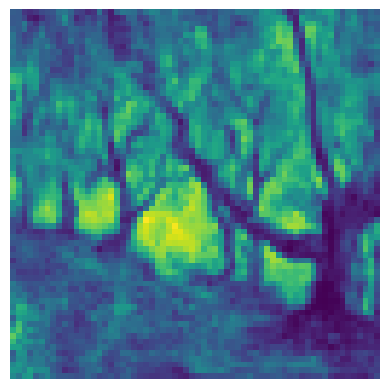

In [ ]:
# show some samples
plt.imshow((dataset[1][0][2]))
plt.axis('off')
plt.show()

In [ ]:
gen.train()
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
  )
)

In [ ]:
EPOCHS = 5

In [ ]:
!PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True

In [ ]:
!mkdir ../../outputs
!mkdir ../../outputs/first_wgan

In [ ]:
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)

 # keep seperate from training to not reset seed incase of running training cell > 1
seed = torch.randn(num_examples_to_generate, noise_dim, 1, 1).to(device)

EPOCH [0/5] Batch 0/10 Loss D: -21.6016, loss G: 30.5727


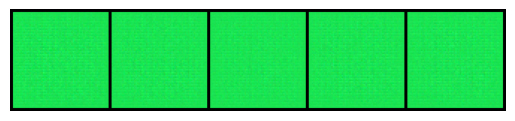

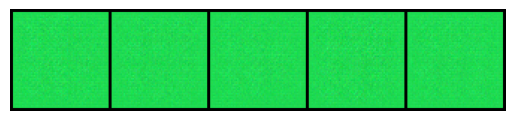

In [ ]:
#training

for epoch in range(EPOCHS):
  for batch_idx, (real_img, _) in enumerate(dataloader):
    real = real_img.to(device)
    if len(real) < 32: # sometimes had tensor of size 12
        break

    for _ in range(DISC_ITERATIONS):
      noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1).to(device)
      fake = gen(noise)
      disc_real = disc(real).reshape(-1)
      disc_fake = disc(fake).reshape(-1)
      gp = gradient_penalty(disc, real, fake, device=device)
      loss_disc = (
          -(torch.mean(disc_real) - torch.mean(disc_fake)) + LAMBDA_GP*gp
      )
      disc.zero_grad()
      loss_disc.backward(retain_graph=True)
      opt_disc.step()

    output = disc(fake).reshape(-1)
    loss_gen = -torch.mean(output)
    gen.zero_grad()
    loss_gen.backward()
    opt_gen.step()

    #generate pics
    with torch.no_grad():
        # fake = gen(seed)
        img_grid_fake = torchvision.utils.make_grid(
          fake[:5], normalize=True
        )
        plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        if epoch % 5 == 0 and batch_idx == 0:
          print(
              f"EPOCH [{epoch}/{EPOCHS}] Batch {batch_idx}/{len(dataloader)} Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
          )
          plt.show()

    # generate with seed and save GIF
    with torch.no_grad():
        if epoch % 2 == 0 and batch_idx == 0:
          fake = gen(seed)
          img_grid_fake = torchvision.utils.make_grid(
            fake[:5], normalize=True
          )
          plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
          plt.axis('off')
          plt.savefig('/content/outputs/first_wgan/image_at_epoch_{:04d}.png'.format(epoch + 1))

    step += 1

In [ ]:
anim_file = 'wgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/first_wgan/image*.png')
  # filenames = glob.glob(f"/content/ImageGeneration/monet_jpg")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-37-5a2011aeacd1>:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



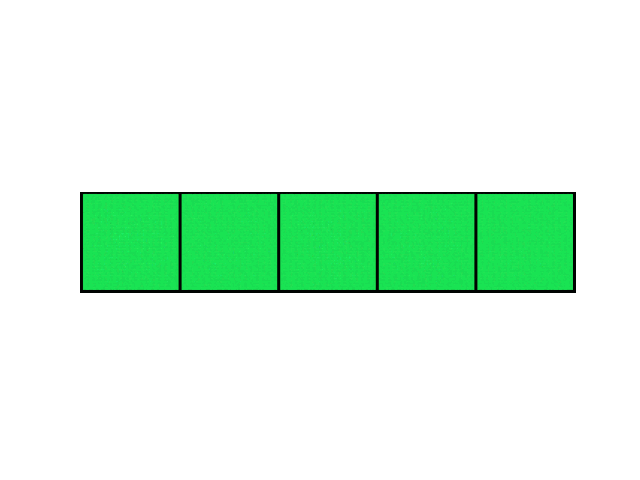

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

In [ ]:
# class Generator(nn.Module):
#   def __init__(self, channels_noise, channels_img, features_g): # (100, 3, 64)
#     super(Generator, self).__init__()
#     self.net = nn.Sequential(
#         self._block(channels_noise, features_g * 16, 4, 2, 0), #(100, 1024, 2, 1, 0)
#         self._block(features_g * 16, features_g * 8, 2, 1, 1),
#         self._block(features_g * 8, features_g * 4, 2, 1, 1),
#         self._block(features_g * 4, features_g * 2, 4, 2, 1), # torch.Size([32, 128, 2, 2])
#         nn.ConvTranspose2d(
#         #     # features_g * 2, channels_img, kernel_size=4, stride=2, padding=1 #[32, 256, 0, 0]
#         #     # features_g * 2, channels_img, kernel_size=2, stride=1, padding=1 #[32, 256, 0, 0]
#         #     # features_g * 2, channels_img, kernel_size=4, stride=1, padding=1 # [32, 256, 0, 0]
#             features_g * 2, channels_img, kernel_size=4, stride=1, padding=1 # [32, 256, 0, 0]
#         ),
#         nn.Tanh(),
#     )

#   def _block(self, in_channels, out_channels, kernel_size, stride, padding):
#     print("_block.in_channels: ", in_channels)
#     print("_block.out_channels: ", out_channels)


#     return nn.Sequential(
#         nn.ConvTranspose2d(
#             in_channels,
#             out_channels,
#             kernel_size,
#             stride,
#             padding,
#             bias=False,
#         ),
#         nn.BatchNorm2d(out_channels),
#         nn.ReLU(),
#     )

#   def forward(self, x):
#     print("forward.len(x): ", len(x))
#     print("forward.x.shape: ", x.shape)
#     print("forward.type(x): ", type(x))
#     # print("forward.x: ", x)
#     return self.net(x)


# def initialize_weights(model):
#     # Initializes weights according to the DCGAN paper
#     for m in model.modules():
#         if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
#             nn.init.normal_(m.weight.data, 0.0, 0.02)


# def test():
#     N, in_channels, H, W = 8, 3, 64, 64
#     noise_dim = 100
#     x = torch.randn((N, in_channels, H, W))
#     disc = Discriminator(in_channels, 8)
#     assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
#     gen = Generator(noise_dim, in_channels, 8)
#     z = torch.randn((N, noise_dim, 1, 1))
#     assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"


In [ ]:
#############################
###    WGAN-GP Attempt    ###
#############################

In [1]:
import glob
import imageio
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time
import matplotlib.image as mpimg

from IPython import display
from IPython.display import HTML
import zipfile
import re
from PIL import Image
import shutil
import matplotlib.animation as animation

In [2]:
#for WGAN-GP
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter

In [3]:
!pip install tensorflow_docs
import tensorflow_docs.vis.embed as embed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.5/182.5 kB 2.2 MB/s eta 0:00:00


In [4]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


In [5]:
#Gather images
!git clone https://github.com/LyJacky/ImageGeneration.git

Cloning into 'ImageGeneration'...
remote: Enumerating objects: 375, done.
remote: Counting objects: 100% (70/70), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 375 (delta 27), reused 69 (delta 26), pack-reused 305
Receiving objects: 100% (375/375), 49.93 MiB | 28.58 MiB/s, done.
Resolving deltas: 100% (27/27), done.


In [6]:
"""
latent dim 125
(grid output, vibrant colors) gen-layer 2048
gen-layer 1536 -> might be my output layer

rotated image gave decent results

batch to 48


added = functional.five_crop(img[0], 32)
"""

'\nlatent dim 125\n(grid output, vibrant colors) gen-layer 2048\ngen-layer 1536 -> might be my output layer\n\n\nchange init dim\n\nrotated image gave decent results\n\nbatch to 48\n\n\nbruh = functional.five_crop(img[0], 32)\n'

In [7]:
""""
change init dim
dataset = datasets.

- change cpu in gradient_penalty?
- different learning rates for disc, gen
- (didnt work, cuda runs out of memory) image size = 256, FEATURES_DISC = 256, FEATURES_GEN = 256
- batch 64 (less than 64 breaks break)
- if RuntimeError: Calculated padded input size per channel: (3 x 3). Kernel size: (4 x 4). \
    - resize image to 64


Attention Mechanisms: Used to focus on specific regions of the input, improving the quality of generated samples.
Generator: Transposed Convolutional (Deconvolutional) Layers: These layers “upsample” the data, allowing the generator to create higher-resolution images.
Discri Pooling Layers: Used to downsample feature maps, reducing spatial dimensions.



- padding = 2 # used to be 1
- kernel size = 5

init weights

Constrain Critic Weights:
After each mini-batch update, limit the critic model weights to a specific range (e.g., [-0.01, 0.01]).
This constraint prevents the critic from becoming too dominant and ensures stability during training.
"""

'"\ndataset = datasets.\n\n- change cpu in gradient_penalty?\n- different learning rates for disc, gen\n- (didnt work, cuda runs out of memory) image size = 256, FEATURES_DISC = 256, FEATURES_GEN = 256\n- batch 64 (less than 64 breaks break)\n- if RuntimeError: Calculated padded input size per channel: (3 x 3). Kernel size: (4 x 4).     - resize image to 64\n\n\nAttention Mechanisms: Used to focus on specific regions of the input, improving the quality of generated samples.\nGenerator: Transposed Convolutional (Deconvolutional) Layers: These layers “upsample” the data, allowing the generator to create higher-resolution images.\nDiscri Pooling Layers: Used to downsample feature maps, reducing spatial dimensions.\n\n\n\n- padding = 2 # used to be 1\n- kernel size = 5\n\ninit weights\n\nConstrain Critic Weights:\nAfter each mini-batch update, limit the critic model weights to a specific range (e.g., [-0.01, 0.01]).\nThis constraint prevents the critic from becoming too dominant and ensure

In [8]:
def gradient_penalty(disc, real, fake, device="cpu"):
  # print("gradient_penalty.real.shape: ", real.shape)
  # print("gradient_penalty.fake.shape: ", fake.shape)
  BATCH_SIZE, C, H, W = real.shape
  epsilon = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
  interpolated_images = real * epsilon + fake * (1 - epsilon)

  # calcuate discriminator scores
  mixed_scores = disc(interpolated_images)

  gradient = torch.autograd.grad(
      inputs = interpolated_images,
      outputs = mixed_scores,
      grad_outputs = torch.ones_like(mixed_scores),
      create_graph = True,
      retain_graph = True,
  )[0]

  gradient = gradient.view(gradient.shape[0], -1)
  gradient_norm = gradient.norm(2, dim=1)
  gradient_penalty = torch.mean((gradient - 1) ** 2)
  return gradient_penalty

In [9]:
class Discriminator(nn.Module):
  def __init__(self, channels_img, features_d):
    super(Discriminator, self).__init__()
    self.disc = nn.Sequential(
        nn.Conv2d(channels_img, features_d, kernel_size = 4, stride = 2, padding = 1),
        nn.LeakyReLU(0.2),

        #_block(in_channels, out_channels, kernel_size, stride, padding)
        self._block(features_d, features_d * 2, 4, 2, 1),
        self._block(features_d * 2, features_d * 4, 4, 2, 1),
        self._block(features_d * 4, features_d * 8, 4, 2, 1),
        # self._block(features_d * 8, features_d * 16, 4, 2, 1),

        # output is 4x4 (Conv2d turns into 1x1)
        # nn.Conv2d(features_d * 16, 1, kernel_size=4, stride=2, padding=0) #here
        nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0) #here
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        # nn.BatchNorm2d(out_channels),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2),
    )

  def forward(self, x):
    return self.disc(x)

In [10]:
W = 128 # Input size
K = 5 # Filter size
S = 1 # Stride
P = 0 # Padding

In [11]:
output = (((W - K + 2*P)/S) + 1)
output

124.0

In [12]:
class Generator(nn.Module):
  def __init__(self, channels_noise, channels_img, features_g): #(100,3,64)
    super(Generator, self).__init__()
    self.net = nn.Sequential(
        # self._block(channels_noise, features_g * 32, 4, 1, 0),
        # self._block(features_g * 32, features_g * 16, 4, 2, 1),
        self._block(channels_noise, features_g * 24, 4, 1, 0),
        self._block(features_g * 24, features_g * 16, 4, 2, 1),
        self._block(features_g * 16, features_g * 8, 4, 2, 1),
        self._block(features_g * 8, features_g * 4, 4, 2, 1),
        self._block(features_g * 4, features_g * 2, 4, 2, 1),
        nn.ConvTranspose2d(
            features_g * 2, channels_img, kernel_size=3, stride=1, padding=1
        ),
        nn.Tanh(),
    )
  def _block(self, in_channels, out_channels, kernel_size, stride, padding):
    return nn.Sequential(
        nn.ConvTranspose2d(
            in_channels,
            out_channels,
            kernel_size,
            stride,
            padding,
            bias=False,
        ),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(),
    )

  def forward(self, x):
    return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


def test():
    N, in_channels, H, W = 8, 3, 64, 64
    noise_dim = 125
    x = torch.randn((N, in_channels, H, W))
    disc = Discriminator(in_channels, 8)
    assert disc(x).shape == (N, 1, 1, 1), "Discriminator test failed"
    gen = Generator(noise_dim, in_channels, 8)
    z = torch.randn((N, noise_dim, 1, 1))
    assert gen(z).shape == (N, in_channels, H, W), "Generator test failed"


In [13]:
import torchvision.transforms as transforms
import torchvision.transforms.functional as functional

In [14]:
# hyperparameters

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
# LEARNING_RATE = 1e-4
DISCRIMINATOR_LEARNING_RATE = 7e-5
GENERATOR_LEARNING_RATE = 5e-3
BATCH_SIZE = 48
CHANNELS_IMG = 3
Z_DIM = 125
IMAGE_SIZE = 64
FEATURES_DISC = 64
FEATURES_GEN = 64
DISC_ITERATIONS = 5 # used to be 5
LAMBDA_GP = 10 # Loss weight for gradient penalty

transforms = transforms.Compose(
    [
        transforms.Resize(IMAGE_SIZE),
        # transforms.RandomRotation(15),
        # transforms.RandomResizedCrop()
        transforms.ToTensor(),
        # transforms.RandomErasing(p=0.2),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]
        ),

    ]
)

cuda


In [15]:
# checkpoints

def save_checkpoints(state, filename="monet_wgan_gp.pth.tar"):
  print("=> Saving checkpoint")
  torch.save(state, filename)

def load_checpoint(checkpoint, gen, disc):
  print("=> Loading checkpoint")
  gen.load_state_dict(checkpoint['gen'])   # generator
  disc.load_state_dict(checkpoint['disc']) # discriminator

In [16]:
def wgan_generate_images():
    noise = tf.random.normal([BATCH_SIZE, Z_DIM])
    # predictions = gen.predict(noise)
    fake = gen(noise)
    return fake

def wgan_generate_and_plot_images():
    image = wgan_generate_images()
    gen_imgs = 0.5 * image + 0.5
    fig = plt.figure(figsize=(10, 10))
    for i in range(25):
        plt.subplot(5, 5, i+1)
        plt.imshow(gen_imgs[i, :, :, :])
        plt.axis('off')
    plt.show()

In [17]:
!ls

ImageGeneration  sample_data


In [18]:
!cd /ImageGeneration/monet_jpg/

/bin/bash: line 1: cd: /ImageGeneration/monet_jpg/: No such file or directory


In [19]:
!ls

ImageGeneration  sample_data


In [20]:
!rm -r /content/ImageGeneration/ImageGeneration/
!rm -r /content/ImageGeneration/.ipynb_checkpoints/
!rm -r /content/ImageGeneration/.git/

rm: cannot remove '/content/ImageGeneration/.ipynb_checkpoints/': No such file or directory


In [21]:
# make sure to not have image_at_epoch_0010.jpg in the folder

dataset = datasets.ImageFolder(root="/content/ImageGeneration/", transform=transforms)


In [22]:
!rm -r /content/augmented_images/monet/
!rm -r /content/augmented_images/

rm: cannot remove '/content/augmented_images/monet/': No such file or directory
rm: cannot remove '/content/augmented_images/': No such file or directory


In [23]:


###########################################################################################
import os

new_path_for_augmented_files = "/content/augmented_images"
os.mkdir(new_path_for_augmented_files)

new_path_for_augmented_files = "/content/augmented_images/monet"
os.mkdir(new_path_for_augmented_files)

print(len(dataset))

to_pil_image = torchvision.transforms.ToPILImage()

counter = 0
for img in dataset:
  five_images_cropped_from_one = functional.five_crop(img[0], 32)

  for new_img in five_images_cropped_from_one:
    # pil_image = to_pil_image(new_img)
    # pil_image = transforms(pil_image)
    pil_image = to_pil_image(new_img)

    pil_image.save('/content/augmented_images/monet/augmented_image_{:04d}.png'.format(counter + 1))
    counter += 1

augmented_dataset = datasets.ImageFolder(root="/content/augmented_images/", transform=transforms)

###########################################################################################

dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN).to(device)
disc = Discriminator(CHANNELS_IMG, FEATURES_DISC).to(device)
initialize_weights(gen)
initialize_weights(disc)

opt_gen = optim.Adam(gen.parameters(), lr=GENERATOR_LEARNING_RATE, betas=(0.0, 0.9))
opt_disc = optim.Adam(disc.parameters(), lr=DISCRIMINATOR_LEARNING_RATE, betas=(0.0, 0.9))

fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)
step = 0

300


In [24]:
from torch.utils.data import TensorDataset, ConcatDataset, DataLoader


In [25]:
print(augmented_dataset[0][0].shape)
print(len(augmented_dataset))

final_dataset = ConcatDataset([dataset, augmented_dataset])

len(final_dataset)



torch.Size([3, 64, 64])
1500


1800

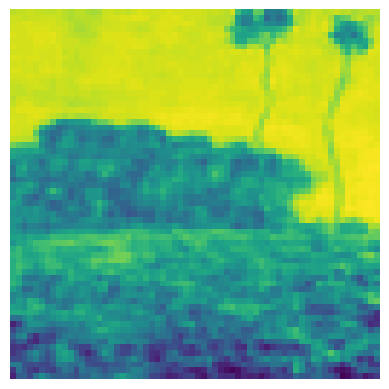

In [26]:
# show some samples
plt.imshow((final_dataset[105][0][2]))
plt.axis('off')
plt.show()

In [27]:
gen.train()

Generator(
  (net): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(125, 1536, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(1536, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(1536, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (3): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (4): Sequential(
      (0)

In [28]:
disc.train()

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (4): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): InstanceNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (5): Conv2d(512, 1, kernel_size=(4, 4), stride=(2, 2))
  )
)

In [29]:
EPOCHS = 500

In [30]:
!PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True
!mkdir /content/outputs
!mkdir /content/outputs/second_wgan

In [31]:
noise_dim = 125
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)

 # keep seperate from training to not reset seed incase of running training cell > 1
seed = torch.randn(num_examples_to_generate, noise_dim, 1, 1).to(device)

EPOCH [0/500] Batch 0/7 Loss D: -16.8826, loss G: 26.3915


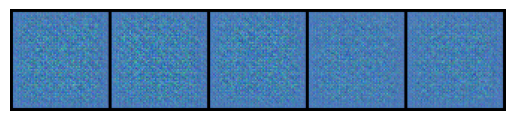

EPOCH [5/500] Batch 0/7 Loss D: -30.1621, loss G: -22.8253


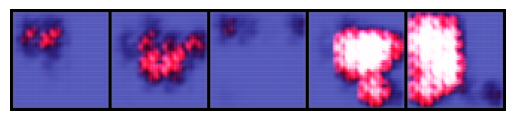

EPOCH [10/500] Batch 0/7 Loss D: -141.9816, loss G: 96.8169


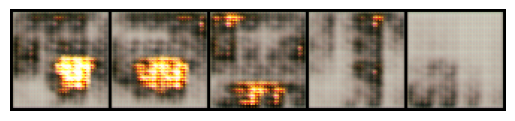

EPOCH [15/500] Batch 0/7 Loss D: -80.2165, loss G: 81.6917


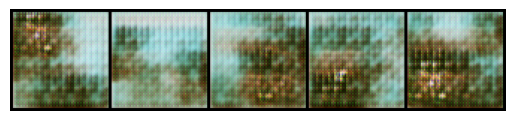

EPOCH [20/500] Batch 0/7 Loss D: -1.0844, loss G: -144.0965


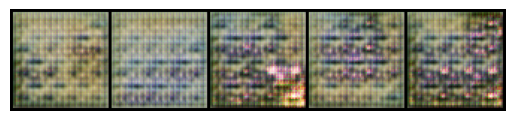

EPOCH [25/500] Batch 0/7 Loss D: -50.4487, loss G: -26.1273


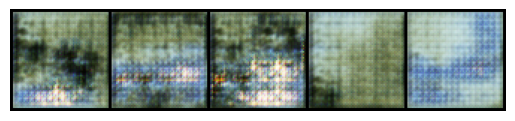

EPOCH [30/500] Batch 0/7 Loss D: -8.3734, loss G: -144.8806


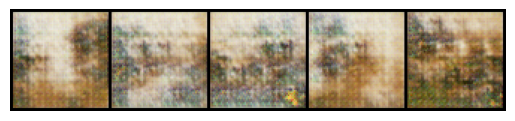

EPOCH [35/500] Batch 0/7 Loss D: -168.7099, loss G: 130.1362


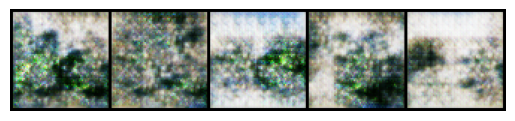

EPOCH [40/500] Batch 0/7 Loss D: -113.6406, loss G: 28.0475


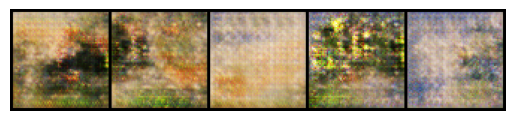

EPOCH [45/500] Batch 0/7 Loss D: -242.4603, loss G: 144.0348


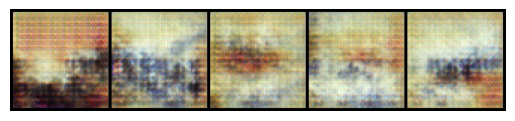

EPOCH [50/500] Batch 0/7 Loss D: -292.2113, loss G: 225.9174


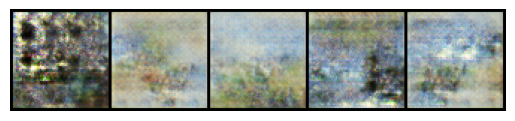

EPOCH [55/500] Batch 0/7 Loss D: -262.2007, loss G: 207.0034


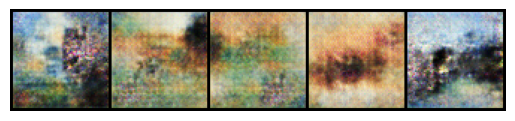

EPOCH [60/500] Batch 0/7 Loss D: -318.9952, loss G: 242.5317


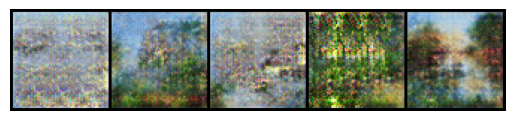

EPOCH [65/500] Batch 0/7 Loss D: -347.7076, loss G: 59.1159


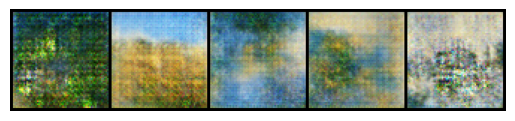

EPOCH [70/500] Batch 0/7 Loss D: -310.6234, loss G: 51.5222


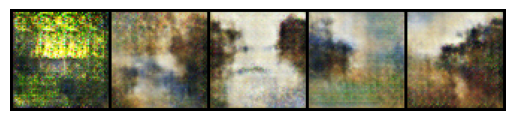

EPOCH [75/500] Batch 0/7 Loss D: -348.1608, loss G: 79.5026


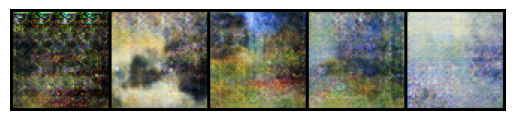

EPOCH [80/500] Batch 0/7 Loss D: -520.4546, loss G: 184.9949


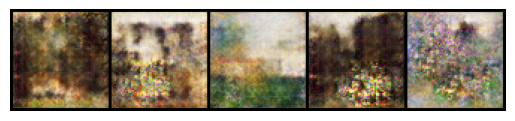

EPOCH [85/500] Batch 0/7 Loss D: -516.4167, loss G: 59.9856


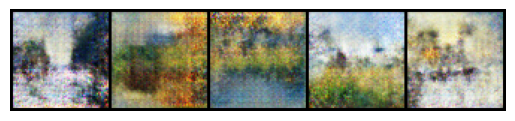

EPOCH [90/500] Batch 0/7 Loss D: -583.1572, loss G: 509.6665


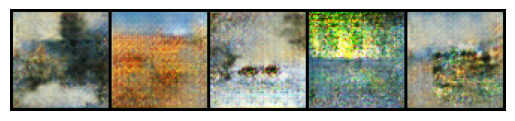

EPOCH [95/500] Batch 0/7 Loss D: -639.7061, loss G: 125.0281


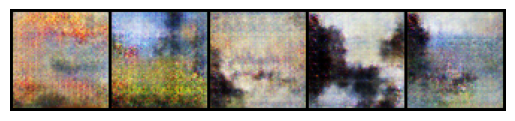

EPOCH [100/500] Batch 0/7 Loss D: -673.8840, loss G: 198.7013


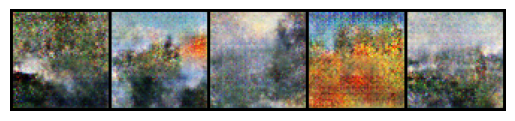

EPOCH [105/500] Batch 0/7 Loss D: -682.8646, loss G: 61.8540


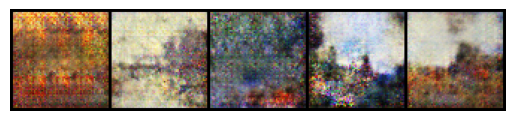

EPOCH [110/500] Batch 0/7 Loss D: -695.5316, loss G: 159.3209


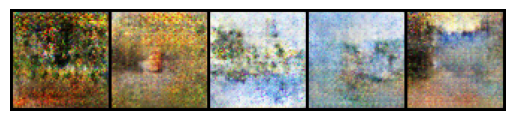

EPOCH [115/500] Batch 0/7 Loss D: -781.1284, loss G: 366.8411


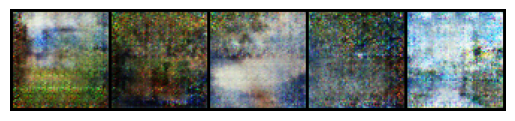

EPOCH [120/500] Batch 0/7 Loss D: -1012.9980, loss G: 231.1830


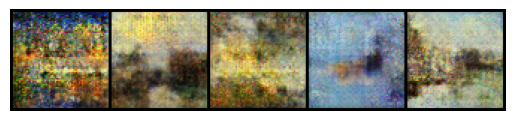

EPOCH [125/500] Batch 0/7 Loss D: -995.4775, loss G: 287.5177


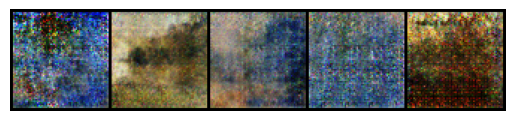

EPOCH [130/500] Batch 0/7 Loss D: -1116.1625, loss G: 366.1998


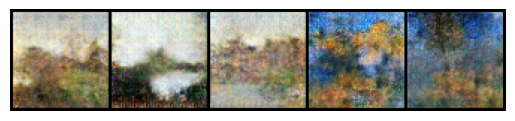

EPOCH [135/500] Batch 0/7 Loss D: -1210.5200, loss G: 352.4596


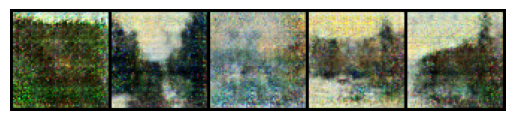

EPOCH [140/500] Batch 0/7 Loss D: -1528.1118, loss G: 1034.6532


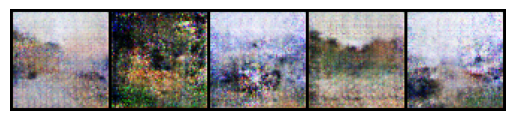

EPOCH [145/500] Batch 0/7 Loss D: -1402.1060, loss G: 431.1169


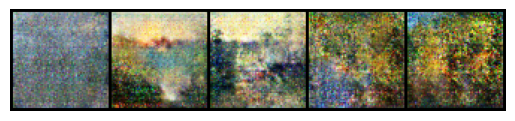

EPOCH [150/500] Batch 0/7 Loss D: -1575.3289, loss G: 668.6829


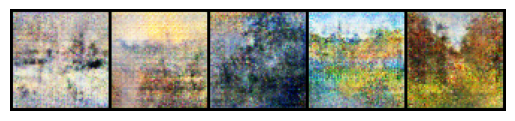

EPOCH [155/500] Batch 0/7 Loss D: -1659.8835, loss G: 1290.9293


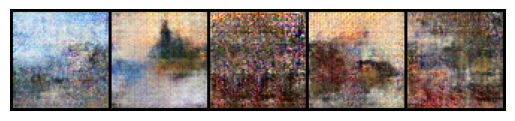

EPOCH [160/500] Batch 0/7 Loss D: -1926.8381, loss G: 1407.4719


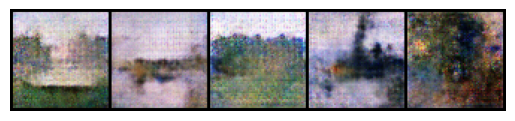

EPOCH [165/500] Batch 0/7 Loss D: -1910.9551, loss G: 780.9850


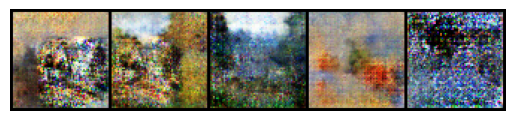

EPOCH [170/500] Batch 0/7 Loss D: -2000.2961, loss G: 1475.3972


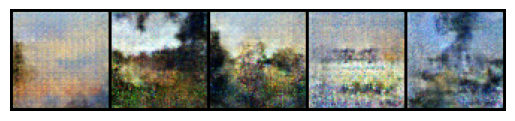

EPOCH [175/500] Batch 0/7 Loss D: -1996.9888, loss G: 810.6667


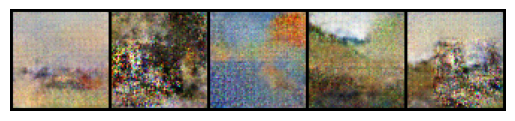

EPOCH [180/500] Batch 0/7 Loss D: -2091.6782, loss G: 810.5644


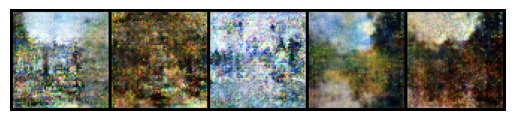

EPOCH [185/500] Batch 0/7 Loss D: -2349.9927, loss G: 1648.0262


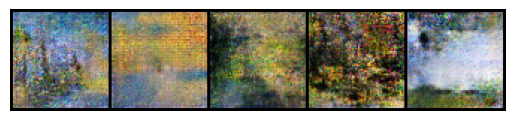

EPOCH [190/500] Batch 0/7 Loss D: -2516.7351, loss G: 1194.8044


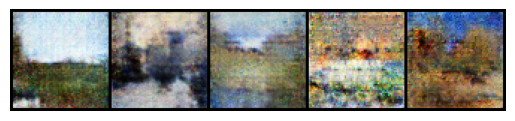

EPOCH [195/500] Batch 0/7 Loss D: -2577.6306, loss G: 1110.1089


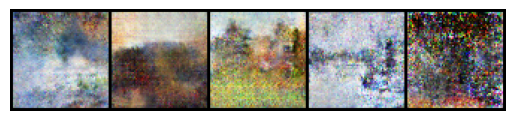

EPOCH [200/500] Batch 0/7 Loss D: -2451.0845, loss G: 817.6202


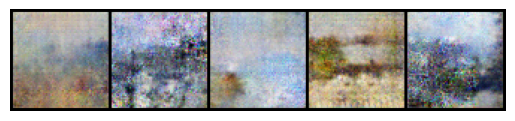

EPOCH [205/500] Batch 0/7 Loss D: -3133.8857, loss G: 1737.9349


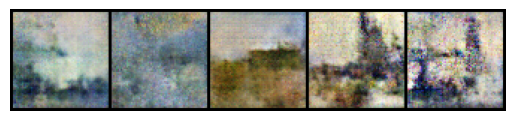

EPOCH [210/500] Batch 0/7 Loss D: -3008.8440, loss G: 1801.4272


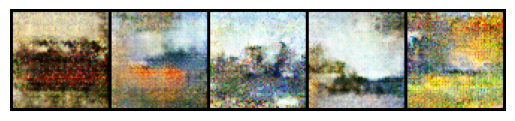

EPOCH [215/500] Batch 0/7 Loss D: -3097.7664, loss G: 2199.8828


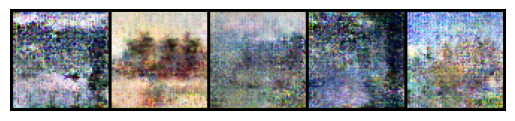

EPOCH [220/500] Batch 0/7 Loss D: -2893.1692, loss G: 2272.8853


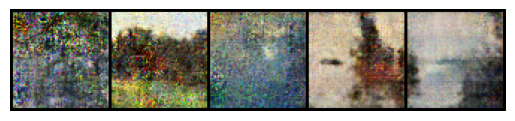

EPOCH [225/500] Batch 0/7 Loss D: -3426.2207, loss G: 1546.7957


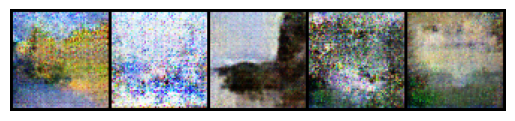

EPOCH [230/500] Batch 0/7 Loss D: -3483.8931, loss G: 2536.3438


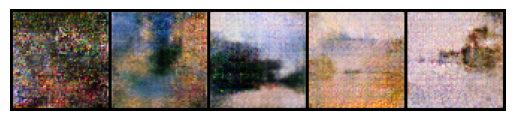

EPOCH [235/500] Batch 0/7 Loss D: -3993.4463, loss G: 2627.7078


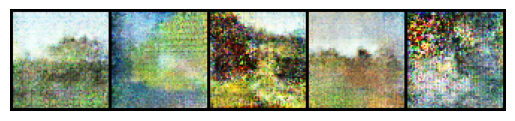

EPOCH [240/500] Batch 0/7 Loss D: -4017.7603, loss G: 2616.7593


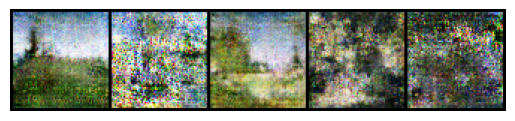

EPOCH [245/500] Batch 0/7 Loss D: -4164.3262, loss G: 1620.2344


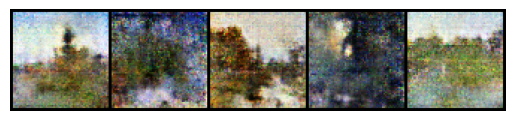

EPOCH [250/500] Batch 0/7 Loss D: -4203.4956, loss G: 2040.7087


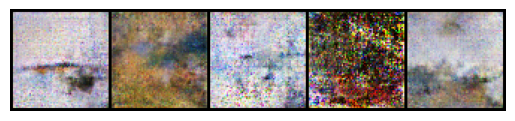

EPOCH [255/500] Batch 0/7 Loss D: -4339.8462, loss G: 1701.0951


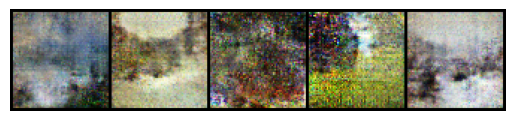

EPOCH [260/500] Batch 0/7 Loss D: -4648.0425, loss G: 2364.1768


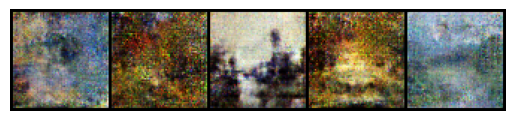

EPOCH [265/500] Batch 0/7 Loss D: -4770.8408, loss G: 2255.6523


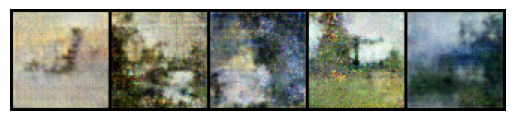

EPOCH [270/500] Batch 0/7 Loss D: -4564.8164, loss G: 3273.6138


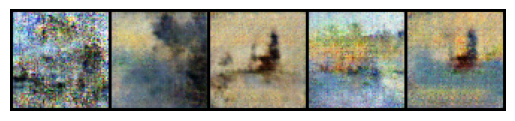

EPOCH [275/500] Batch 0/7 Loss D: -5021.5918, loss G: 3404.6245


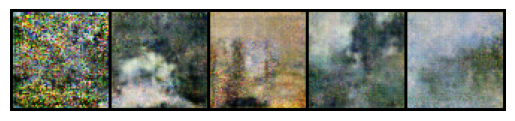

EPOCH [280/500] Batch 0/7 Loss D: -5708.9653, loss G: 2706.3887


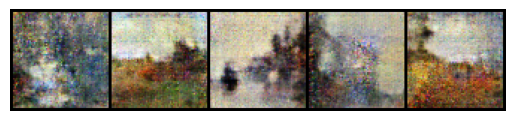

EPOCH [285/500] Batch 0/7 Loss D: -5451.0850, loss G: 3731.1277


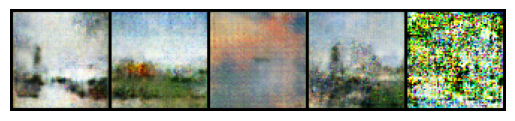

EPOCH [290/500] Batch 0/7 Loss D: -5734.7422, loss G: 3561.3250


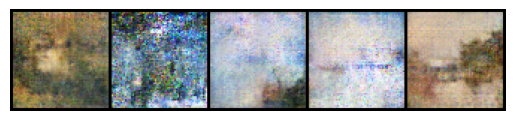

EPOCH [295/500] Batch 0/7 Loss D: -5950.2085, loss G: 2848.5020


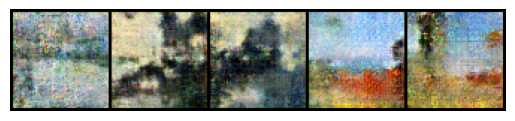

EPOCH [300/500] Batch 0/7 Loss D: -6255.1421, loss G: 3920.6375


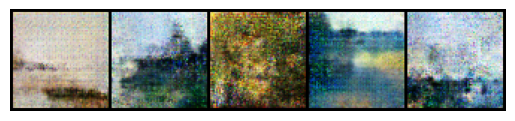

EPOCH [305/500] Batch 0/7 Loss D: -6539.6816, loss G: 3347.5596


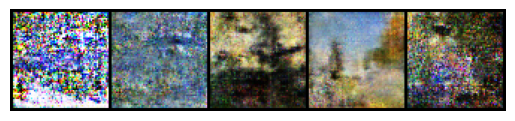

EPOCH [310/500] Batch 0/7 Loss D: -7046.6777, loss G: 4213.0571


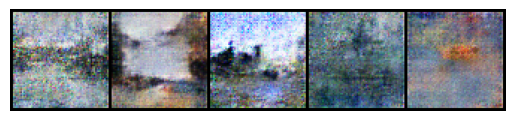

EPOCH [315/500] Batch 0/7 Loss D: -6398.1748, loss G: 4364.1030


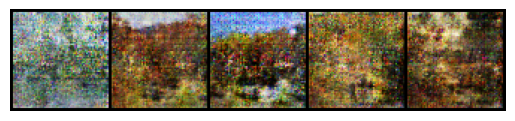

EPOCH [320/500] Batch 0/7 Loss D: -7067.7422, loss G: 3425.8933


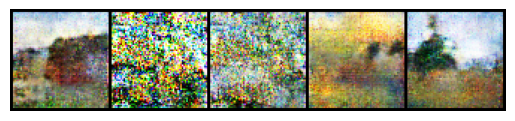

EPOCH [325/500] Batch 0/7 Loss D: -7705.2969, loss G: 4406.0332


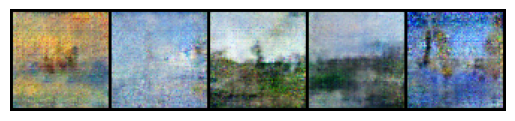

EPOCH [330/500] Batch 0/7 Loss D: -7567.9150, loss G: 4004.0527


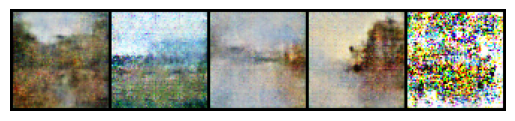

EPOCH [335/500] Batch 0/7 Loss D: -7612.4951, loss G: 4162.5615


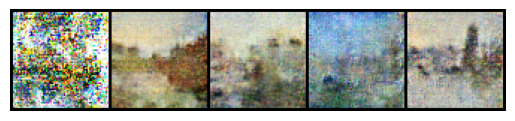

EPOCH [340/500] Batch 0/7 Loss D: -8078.8413, loss G: 5004.9253


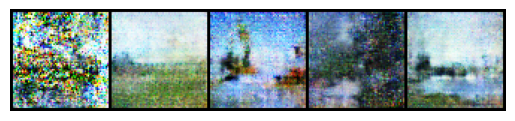

EPOCH [345/500] Batch 0/7 Loss D: -7879.2188, loss G: 5167.1074


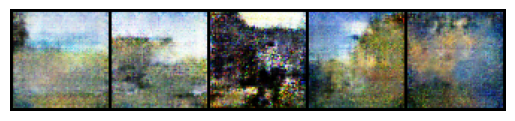

EPOCH [350/500] Batch 0/7 Loss D: -8861.2090, loss G: 4482.0566


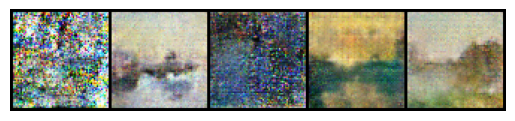

EPOCH [355/500] Batch 0/7 Loss D: -8576.5039, loss G: 5427.4346


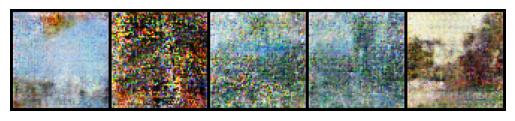

EPOCH [360/500] Batch 0/7 Loss D: -8445.7520, loss G: 4361.8086


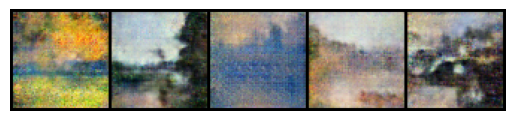

EPOCH [365/500] Batch 0/7 Loss D: -8958.3164, loss G: 5884.0718


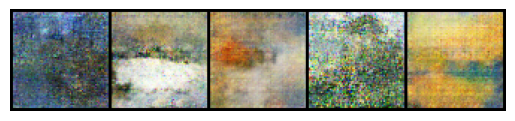

EPOCH [370/500] Batch 0/7 Loss D: -8982.8359, loss G: 5866.8687


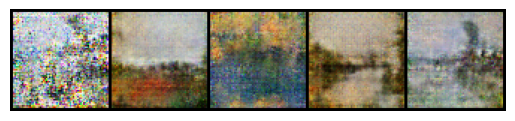

EPOCH [375/500] Batch 0/7 Loss D: -9148.0088, loss G: 4450.3447


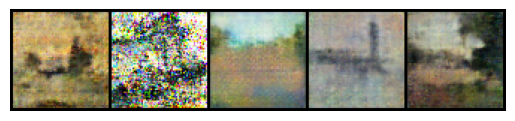

EPOCH [380/500] Batch 0/7 Loss D: -9871.7305, loss G: 5701.9824


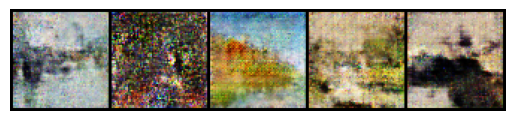

EPOCH [385/500] Batch 0/7 Loss D: -9261.2666, loss G: 6040.2437


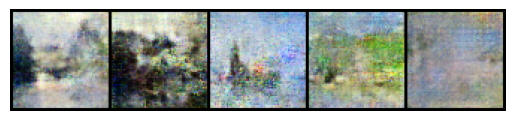

EPOCH [390/500] Batch 0/7 Loss D: -10545.7285, loss G: 5608.7305


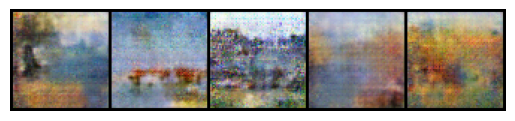

EPOCH [395/500] Batch 0/7 Loss D: -10821.7939, loss G: 5965.9858


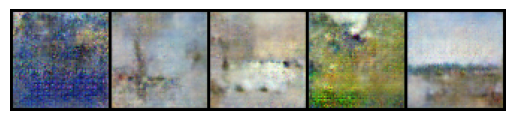

EPOCH [400/500] Batch 0/7 Loss D: -10560.1104, loss G: 6089.0107


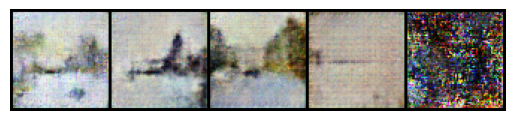

EPOCH [405/500] Batch 0/7 Loss D: -11248.7520, loss G: 6634.3042


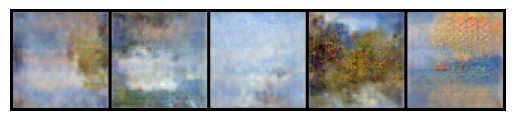

EPOCH [410/500] Batch 0/7 Loss D: -11679.2939, loss G: 6207.2959


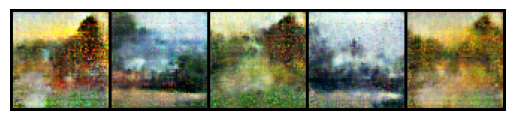

EPOCH [415/500] Batch 0/7 Loss D: -12172.5000, loss G: 6468.8628


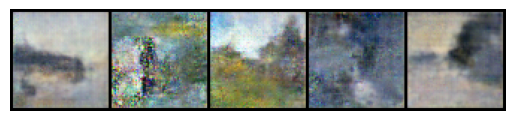

EPOCH [420/500] Batch 0/7 Loss D: -11775.4766, loss G: 6362.7188


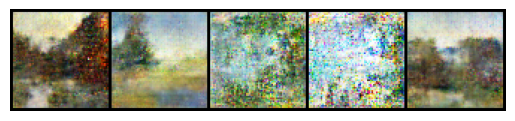

EPOCH [425/500] Batch 0/7 Loss D: -12622.4883, loss G: 7257.7754


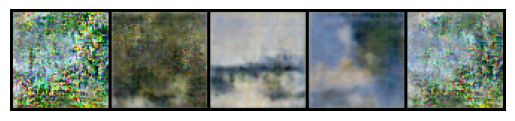

EPOCH [430/500] Batch 0/7 Loss D: -12145.6113, loss G: 7168.0601


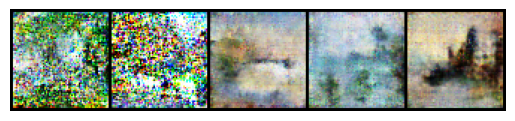

EPOCH [435/500] Batch 0/7 Loss D: -12863.3447, loss G: 6427.2085


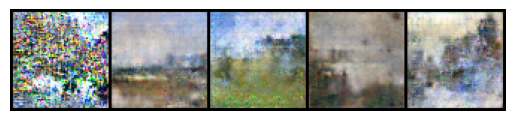

EPOCH [440/500] Batch 0/7 Loss D: -13457.2402, loss G: 7199.9683


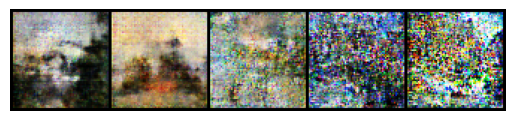

EPOCH [445/500] Batch 0/7 Loss D: -13421.3467, loss G: 8065.3926


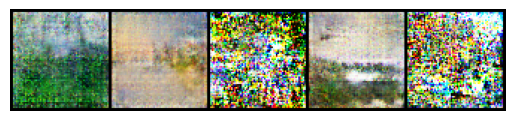

KeyboardInterrupt: 

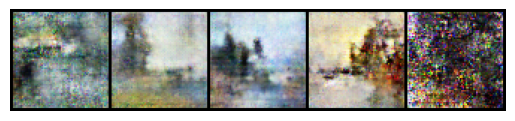

In [32]:
#training

for epoch in range(EPOCHS):
  for batch_idx, (real_img, _) in enumerate(dataloader):
    real = real_img.to(device)
    if len(real) < 32: # sometimes had tensor of size 12
        break

    for _ in range(DISC_ITERATIONS):
      #                           32,
      noise = torch.randn(BATCH_SIZE, Z_DIM, 1, 1).to(device)
      # print("noise.shape: ", noise.shape)
      fake = gen(noise)
      disc_real = disc(real).reshape(-1)
      # print("real.shape: ", real.shape)
      # print("fake.shape: ", fake.shape)
      # print("disc(fake): ", disc(fake))
      disc_fake = disc(fake).reshape(-1)
      gp = gradient_penalty(disc, real, fake, device=device)
      loss_disc = (
          -(torch.mean(disc_real) - torch.mean(disc_fake)) + LAMBDA_GP*gp
      )
      disc.zero_grad()
      loss_disc.backward(retain_graph=True)
      opt_disc.step()

    output = disc(fake).reshape(-1)
    loss_gen = -torch.mean(output)
    gen.zero_grad()
    loss_gen.backward()
    opt_gen.step()

    #generate pics
    with torch.no_grad():
        # fake = gen(seed)
        img_grid_fake = torchvision.utils.make_grid(
          fake[:5], normalize=True
        )
        plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
        plt.axis('off')
        if epoch % 5 == 0 and batch_idx == 0:
          print(
              f"EPOCH [{epoch}/{EPOCHS}] Batch {batch_idx}/{len(dataloader)} Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}"
          )
          plt.show()

    # generate with seed and save GIF
    with torch.no_grad():
        if epoch % 2 == 0 and batch_idx == 0:
          fake = gen(seed)
          img_grid_fake = torchvision.utils.make_grid(
            fake[:5], normalize=True
          )
          plt.imshow(img_grid_fake.cpu().detach().numpy().transpose(1, 2, 0))
          plt.axis('off')
          plt.savefig('/content/outputs/second_wgan/image_at_epoch_{:04d}.png'.format(epoch + 1))

    step += 1

In [33]:
anim_file = 'wgan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('/content/outputs/second_wgan/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-33-ad18286ff9b6>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



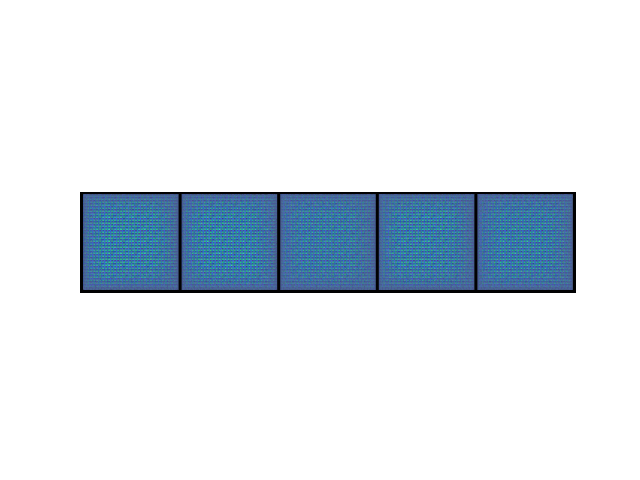

In [34]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)